In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
sns.set()

from PIL import Image
!pip install wordcloud
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator


import os

print(os.listdir(r"C:\Users\mouli\OneDrive\Desktop\input"))



from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split

from scipy.stats import boxcox

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

Defaulting to user installation because normal site-packages is not writeable
['en.openfoodfacts.org.products.tsv']


In [2]:
original = pd.read_csv(r"C:\Users\mouli\OneDrive\Desktop\input\en.openfoodfacts.org.products.tsv",
                       delimiter='\t',
                       encoding='utf-8')

original.head()

C:\Users\mouli\AppData\Local\Temp\ipykernel_26148\959493403.py:1: DtypeWarning:

Columns (0,3,5,19,20,24,25,26,27,28,36,37,38,39,48) have mixed types. Specify dtype option on import or set low_memory=False.



,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,fruits-vegetables-nuts_100g,fruits-vegetables-nuts-estimate_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
0,3087,http://world-en.openfoodfacts.org/product/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,NaN,1kg,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4530,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN
2,4559,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Peanuts,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN
3,16087,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489055731,2017-03-09T10:35:31Z,1489055731,2017-03-09T10:35:31Z,Organic Salted Nut Mix,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,12.0,NaN,NaN
4,16094,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489055653,2017-03-09T10:34:13Z,1489055653,2017-03-09T10:34:13Z,Organic Polenta,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
original.shape

(356027, 163)

In [4]:
original.product_name = original.product_name.astype(str)

In [5]:
original.columns.values

array(['code', 'url', 'creator', 'created_t', 'created_datetime',
       'last_modified_t', 'last_modified_datetime', 'product_name',
       'generic_name', 'quantity', 'packaging', 'packaging_tags',
       'brands', 'brands_tags', 'categories', 'categories_tags',
       'categories_en', 'origins', 'origins_tags', 'manufacturing_places',
       'manufacturing_places_tags', 'labels', 'labels_tags', 'labels_en',
       'emb_codes', 'emb_codes_tags', 'first_packaging_code_geo',
       'cities', 'cities_tags', 'purchase_places', 'stores', 'countries',
       'countries_tags', 'countries_en', 'ingredients_text', 'allergens',
       'allergens_en', 'traces', 'traces_tags', 'traces_en',
       'serving_size', 'no_nutriments', 'additives_n', 'additives',
       'additives_tags', 'additives_en', 'ingredients_from_palm_oil_n',
       'ingredients_from_palm_oil', 'ingredients_from_palm_oil_tags',
       'ingredients_that_may_be_from_palm_oil_n',
       'ingredients_that_may_be_from_palm_oil',
   

In [6]:
original["nutrition-score-fr_100g"].isnull().value_counts()

nutrition-score-fr_100g
False    254856
True     101171
Name: count, dtype: int64

In [7]:
def get_outliers(log_prob, treshold):
    epsilon = np.quantile(log_prob, treshold)
    outliers = np.where(log_prob <= epsilon, 1, 0)
    return outliers 

def make_word_cloud(data, cluster, subplotax, title):
    words = data[data.cluster==cluster]["product"].apply(lambda l: l.lower().split())
    cluster_words=words.apply(pd.Series).stack().reset_index(drop=True)
    frequencies = cluster_words.value_counts()
    
    text = " ".join(w for w in cluster_words)

    # Create and generate a word cloud image:
    wordcloud = WordCloud(max_font_size=40, max_words=30,
                          background_color="white", colormap="magma")
    wordcloud.generate_from_frequencies(frequencies)
    # Display the generated image:
    subplotax.imshow(wordcloud, interpolation='bilinear')
    subplotax.axis("off")
    subplotax.set_title(title)
    return subplotax

def split_data_by_nan(cutoff):
    cols_of_interest = nan_values[nan_values <= cutoff].index
    data = original[cols_of_interest]    
    return data.copy()

def transform(data, feature, constant, lam):
    scaler = MinMaxScaler((0,5))
    scaled_feature = scaler.fit_transform(data[feature].values.copy().reshape(-1,1))
    data["boxcox_" + feature] = boxcox(scaled_feature + constant, lam)
    scaler = StandardScaler()
    data["transformed_" + feature] = scaler.fit_transform(data["boxcox_" + feature].values.reshape(-1,1))
    return data


class TransformParameter:
 
    def __init__(self, const, lam, color="Dodgerblue"):
        self.const = const
        self.lam = lam
        self.color = color

def make_violin(subax, cluster, nutrients):
    pos = np.arange(1, len(nutrients)+1)
    part = subax.violinplot(
            nutrition_table[nutrition_table.cluster==cluster]
                [nutrients].values,            showmeans=True,
            showextrema=False)
    subax.set_title("Feature distributions of cluster: " + str(cluster), size = 20)
    subax.set_xticks(pos)
    subax.set_xticklabels(nutrients)
    set_color(part, len(nutrients))
    return subax

def set_color(axes, num_colors):
    cm = plt.cm.get_cmap('RdYlBu_r')
    NUM_COLORS=num_colors
    for n in range(len(axes["bodies"])):
        pc = axes["bodies"][n]
        pc.set_facecolor(cm(1.*n/NUM_COLORS))
        pc.set_edgecolor('black')
    return axes

In [8]:
nutrition_table_cols = ["energy_100g",
                        "fat_100g",
                        "carbohydrates_100g",
                        "sugars_100g",
                        "proteins_100g",
                        "salt_100g"]

In [9]:
nutrition_table = original[nutrition_table_cols].copy()

nutrition_table["isempty"] = np.where(nutrition_table.isnull().sum(axis=1) >= 1, 1, 0)
percentage = nutrition_table.isempty.value_counts()[1] / nutrition_table.shape[0] * 100
print("Percentage of incomplete tables: " + str(percentage))

nutrition_table = nutrition_table[nutrition_table.isempty==0].copy()
nutrition_table.isnull().sum()

nutrition_table.drop("isempty", inplace=True,axis=1)
nutrition_table.dropna(axis = 0, how = "any", inplace=True)

Percentage of incomplete tables: 26.88307347476455


In [10]:
nutrition_table.shape[0]

260316

In [11]:
nutrition_table["g_sum"] = nutrition_table.fat_100g + nutrition_table.carbohydrates_100g + nutrition_table.proteins_100g + nutrition_table.salt_100g
nutrition_table["g_sum"] = round(nutrition_table.g_sum)
nutrition_table["other_carbs"] = nutrition_table.carbohydrates_100g - nutrition_table.sugars_100g

nutrition_table["reconstructed_energy"] = nutrition_table.fat_100g * 37 + (nutrition_table.proteins_100g + nutrition_table.carbohydrates_100g)* 17

In [12]:
nutrition_table.columns

Index(['energy_100g', 'fat_100g', 'carbohydrates_100g', 'sugars_100g',
       'proteins_100g', 'salt_100g', 'g_sum', 'other_carbs',
       'reconstructed_energy'],
      dtype='object')

In [13]:
meta = pd.DataFrame(index=nutrition_table.index)
for col in nutrition_table.columns:
    meta["zero_" + col] = np.where(nutrition_table[col] == 0, 1, 0)
meta["contains_zero"] = np.where(meta.sum(axis=1) > 0,1,0 )

In [14]:
for col in nutrition_table.columns:
    if col not in ["energy_100g", "reconstructed_energy"]:
        nutrition_table = nutrition_table.loc[nutrition_table[col] <= 100]
    nutrition_table = nutrition_table.loc[nutrition_table[col] >= 0]

nutrition_table = nutrition_table.loc[nutrition_table.energy_100g <= 3700]
nutrition_table = nutrition_table.loc[nutrition_table.carbohydrates_100g >= nutrition_table.sugars_100g]
nutrition_table = nutrition_table.loc[nutrition_table.g_sum <= 100]

In [15]:
nutrition_table.head()

,energy_100g,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,g_sum,other_carbs,reconstructed_energy
1,2243.0,28.57,64.29,14.29,3.57,0.00000,96.0,50.00,2210.71
2,1941.0,17.86,60.71,17.86,17.86,0.63500,97.0,42.85,1996.51
3,2540.0,57.14,17.86,3.57,17.86,1.22428,94.0,14.29,2721.42
7,1833.0,18.75,57.81,15.62,14.06,0.13970,91.0,42.19,1915.54
12,2230.0,36.67,36.67,3.33,16.67,1.60782,92.0,33.34,2263.57


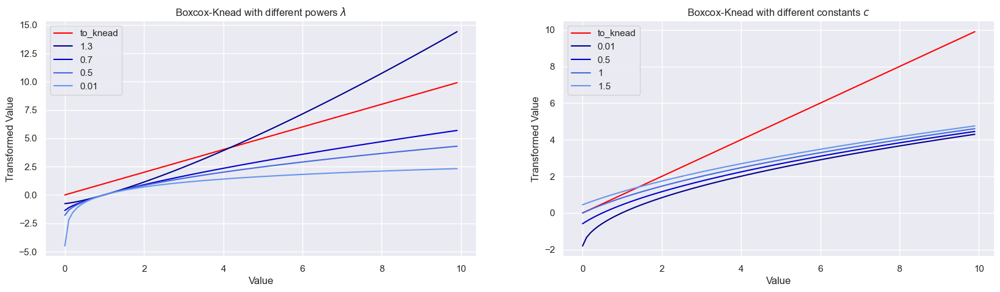

In [16]:
to_knead = np.arange(0, 10, 0.1)

fig, ax = plt.subplots(1, 2, figsize=(20, 5))

# First plot
k = ax[0].plot(to_knead, to_knead, color="Red", label="to_knead")
e1 = ax[0].plot(to_knead, boxcox(to_knead + 0.01, 1.3), color="darkblue", label="1.3")
e2 = ax[0].plot(to_knead, boxcox(to_knead + 0.01, 0.7), color="mediumblue", label="0.7")
e3 = ax[0].plot(to_knead, boxcox(to_knead + 0.01, 0.5), color="royalblue", label="0.5")
e4 = ax[0].plot(to_knead, boxcox(to_knead + 0.01, 0.01), color="cornflowerblue", label="0.01")
ax[0].set_title(r"Boxcox-Knead with different powers $\lambda$")
ax[0].set_xlabel("Value")
ax[0].set_ylabel("Transformed Value")

# Second plot
k = ax[1].plot(to_knead, to_knead, color="Red", label="to_knead")
e1 = ax[1].plot(to_knead, boxcox(to_knead + 0.01, 0.5), color="darkblue", label="0.01")
e2 = ax[1].plot(to_knead, boxcox(to_knead + 0.5, 0.5), color="mediumblue", label="0.5")
e3 = ax[1].plot(to_knead, boxcox(to_knead + 1, 0.5), color="royalblue", label="1")
e4 = ax[1].plot(to_knead, boxcox(to_knead + 1.5, 0.5), color="cornflowerblue", label="1.5")
ax[1].set_title(r"Boxcox-Knead with different constants $c$")
ax[1].set_xlabel("Value")
ax[1].set_ylabel("Transformed Value")

# Add legends
ax[0].legend()
ax[1].legend()

plt.show()


In [17]:
constants = {"carbohydrates_100g": TransformParameter(const=0.01, lam=0.9, color="Green"),
            "fat_100g" : TransformParameter(const=0.1, lam=0.05, color="orange"),
            "proteins_100g": TransformParameter(const=0.1, lam=0.1, color="Red"),
             "sugars_100g" : TransformParameter(const=0.07, lam=0.03, color="Fuchsia"),
            "other_carbs" : TransformParameter(const=0.05, lam=0.3, color="maroon"),
            "salt_100g" : TransformParameter(const=0.01, lam=0.005, color="Dodgerblue"),
            "energy_100g" : TransformParameter(const=0.3, lam=0.7, color="Purple"),
            "reconstructed_energy" : TransformParameter(const=0.3, lam=0.7, color="mediumvioletred"),
            "g_sum": TransformParameter(const=0.1, lam=1.2, color="turquoise")}

In [18]:
for key in constants.keys():
    transform(data=nutrition_table,
              feature=key,
              constant=constants[key].const,
              lam=constants[key].lam)

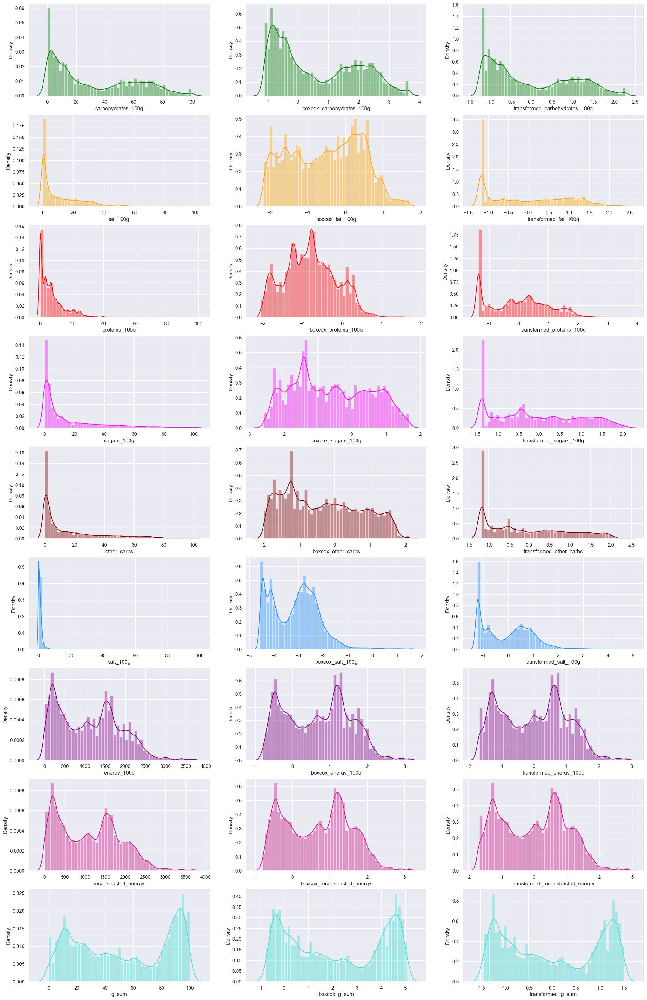

In [19]:
fig, ax = plt.subplots(9,3,figsize=(25,40))
n = 0
for feature in constants.keys():
    sns.distplot(nutrition_table[feature],
                 ax=ax[n,0],
                 color=constants[feature].color)
    sns.distplot(nutrition_table[nutrition_table[feature]>0]["boxcox_" + feature],
                 ax=ax[n,1],
                 color=constants[feature].color)
    sns.distplot(nutrition_table["transformed_" + feature],
                 ax=ax[n,2],
                 color=constants[feature].color)
    n+=1

In [20]:
nutrition_table, test_table = train_test_split(nutrition_table, test_size=0.3, random_state=0)

In [21]:
features = ["transformed_carbohydrates_100g",
            "transformed_fat_100g",
            "transformed_proteins_100g",
            "transformed_sugars_100g",
            "transformed_salt_100g",
            "transformed_other_carbs",
            "transformed_energy_100g",
            "transformed_reconstructed_energy",
            "transformed_g_sum"]

In [22]:
X_train = nutrition_table[features].values
X_test = test_table[features].values

In [23]:
print("Number of train samples: " + str(X_train.shape[0]))

Number of train samples: 179249


In [24]:
# ONLY uncomment, if you have at least an hour time to wait for computation! 
# scores = []
# bic = []
# aic = []
# to_try = range(11,81,10)
# for components in to_try:
    # model = GaussianMixture(n_components=components, covariance_type="full", random_state=1)
    # model.fit(X_train)
    # scores.append(model.score(X_test))
    # bic.append(model.bic(X_test))
    # aic.append(model.aic(X_test))

# fig, ax = plt.subplots(1,3,figsize=(25,5))
# ax[0].plot(to_try, scores)
# ax[1].plot(to_try, bic)
# ax[2].plot(to_try, aic)
# ax[0].set_xlabel("Number of components")
# ax[0].set_ylabel("Log-Likelihood")
# ax[1].set_xlabel("Number of components")
# ax[1].set_title("BIC")
# ax[1].set_ylabel("Penalized Log-Likelihood")
# ax[2].set_ylabel("Penalized Log-Likelihood")
# ax[2].set_xlabel("Number of components")
# ax[2].set_title("AIC")

In [25]:
components = 20

model = GaussianMixture(n_components=components,
                        covariance_type="full",
                        random_state=1,
                        n_init=1,
                        max_iter=200,
                        init_params="kmeans")
model.fit(X_train)
print("Model converged: " + str(model.converged_))

nutrition_table["cluster"] = model.predict(X_train)
test_table["cluster"] = model.predict(X_test)

Model converged: True


In [26]:
plot_features = ["transformed_carbohydrates_100g", "transformed_proteins_100g", "transformed_fat_100g"]
#plot_features = ["carbohydrates_100g", "proteins_100g", "fat_100g"]

In [27]:
nutrition_table["product"] = original.loc[nutrition_table.index, "product_name"]

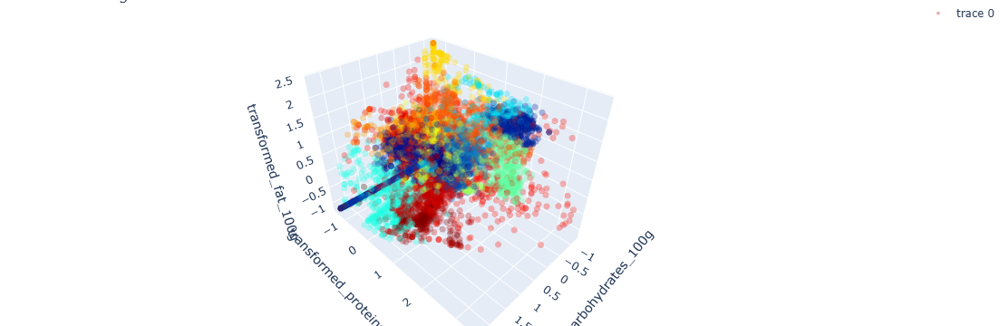

In [28]:
N = 10000

trace1 = go.Scatter3d(
    x=nutrition_table[plot_features[0]].values[0:N], 
    y=nutrition_table[plot_features[1]].values[0:N],
    z=nutrition_table[plot_features[2]].values[0:N],
    mode='markers',
    text=nutrition_table["product"].values[0:N],
    marker=dict(
        color=nutrition_table.cluster.values,
        colorscale = "Jet",
        opacity=0.3,
        size=4
    )
)

figure_data = [trace1]
layout = go.Layout(
    title = 'Clustering results',
    scene = dict(
        xaxis = dict(title=plot_features[0]),
        yaxis = dict(title=plot_features[1]),
        zaxis = dict(title=plot_features[2]),
    ),
        margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    showlegend=True
)

fig = go.Figure(data=figure_data, layout=layout)
py.iplot(fig, filename='simple-3d-scatter')

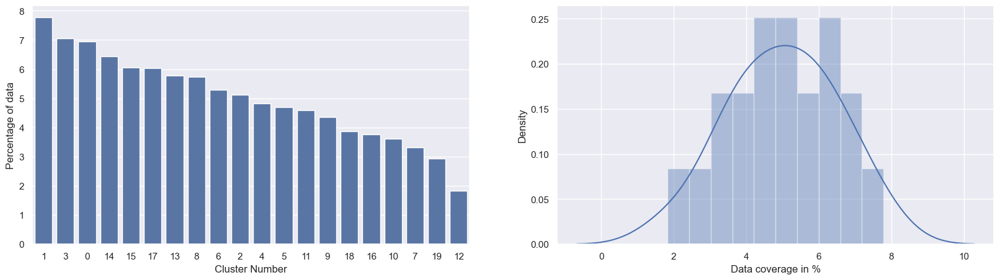

In [29]:
cluster_count = nutrition_table.cluster.value_counts()

fig, ax = plt.subplots(1,2,figsize=(20,5))
sns.barplot(x=cluster_count.index,
            y=cluster_count.values / nutrition_table.shape[0] * 100,
            order=cluster_count.index, ax=ax[0])
ax[0].set_xlabel("Cluster Number")
ax[0].set_ylabel("Percentage of data")
sns.distplot(cluster_count.values / nutrition_table.shape[0] * 100, bins=10, ax=ax[1])
ax[1].set_xlabel("Data coverage in %")
ax[1].set_ylabel("Density");

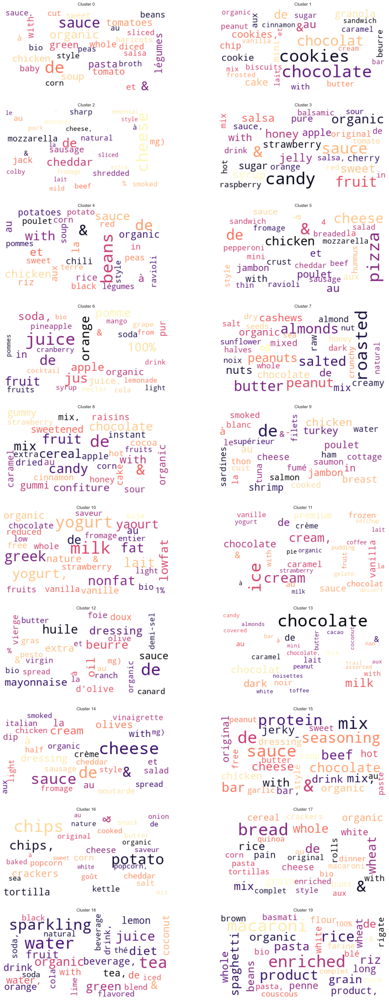

In [30]:
nutrition_table["product"] = original.loc[nutrition_table.index, "product_name"]

fig, ax = plt.subplots(10,2, figsize=(20,50))
for m in range(10):
    for n in range(2):
        cluster = m*2+ n
        title = "Cluster " + str(cluster) 
        make_word_cloud(nutrition_table, cluster, ax[m,n], title)


In [31]:
nutrition_table[nutrition_table["cluster"]==19]["product"].value_counts().head()

product
Spaghetti               70
nan                     58
Pinto Beans             43
Black Beans             26
Great Northern Beans    24
Name: count, dtype: int64

In [32]:
cluster_names = {
    0: "nuts and seeds",
    1: "beans & peas",
    2: "ice cream",
    3: "cookies",
    4: "creams & dips",
    5: "water and diet drinks",
    6: "strange cluster 6",
    7: "gummy bears & fruit snacks",
    8: "yoghurt and milk",
    9: "pasta & noodles",
    10: "cottage cheese and shrimps",
    11: "chips & popcorn",
    12: "strange cluster 12",
    13: "pizza, tortillas",
    14: "cheese",
    15: "chocolate",
    16: "grains & flours",
    17: "mayonnaise & oils",
    18: "tomato sauce",
    19: "sweet drinks"
}

In [33]:
nutrition_table["category"] = nutrition_table.cluster.map(cluster_names)

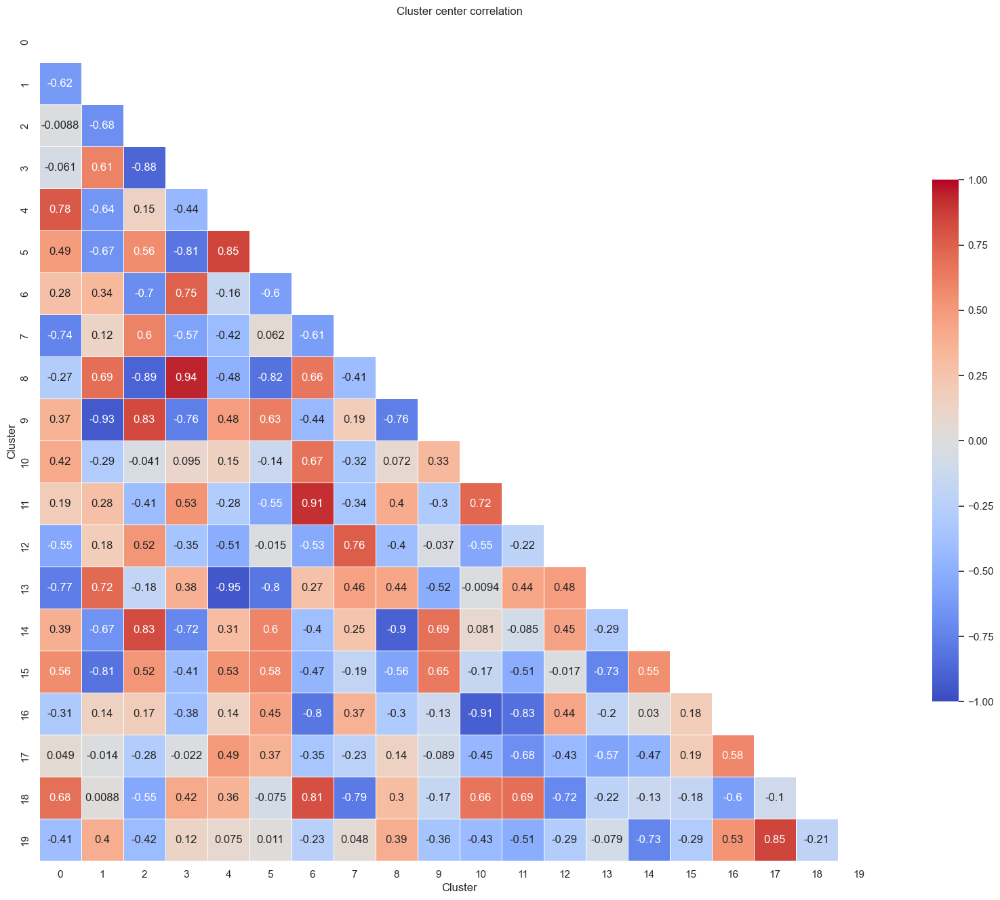

In [34]:
cluster_stats = pd.DataFrame(data=model.means_)
sns.set(style="white")
corr = cluster_stats.transpose().corr()


mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corr, mask=mask, cmap="coolwarm",
            vmin=-1, vmax=1, square=True, center=0,
            linewidths=.5, cbar_kws={"shrink": .5},
           annot=True)
ax.set_xlabel("Cluster")
ax.set_ylabel("Cluster")
ax.set_title("Cluster center correlation");

In [35]:
nutrients = ["fat_100g",
             "proteins_100g",
             "carbohydrates_100g",
             "sugars_100g", 
             "other_carbs",
             "salt_100g",
             "g_sum"]
energies = ["energy_100g", "reconstructed_energy"]

transformed_nutrients = ["transformed_" + nutrient for nutrient in nutrients]
transformed_energies = ["transformed_" + energy for energy in energies]

In [36]:
cluster_pair = [9,16]

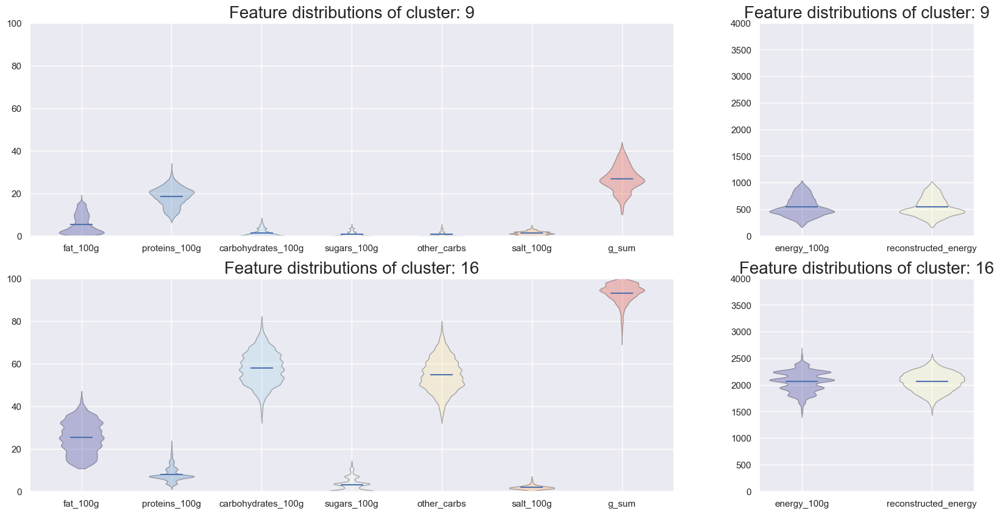

In [37]:
sns.set()

fig, ax = plt.subplots(2,2,gridspec_kw = {'width_ratios':[3, 1]}, figsize=(20,10))
pair00 = make_violin(ax[0,0], cluster_pair[0], nutrients)
ax[0,0].set_ylim([0,100])
pair01 = make_violin(ax[0,1], cluster_pair[0], energies)
ax[0,1].set_ylim([0,4000])
pair10 = make_violin(ax[1,0], cluster_pair[1], nutrients)
ax[1,0].set_ylim([0,100])
pair11 = make_violin(ax[1,1], cluster_pair[1], energies)
ax[1,1].set_ylim([0,4000]);

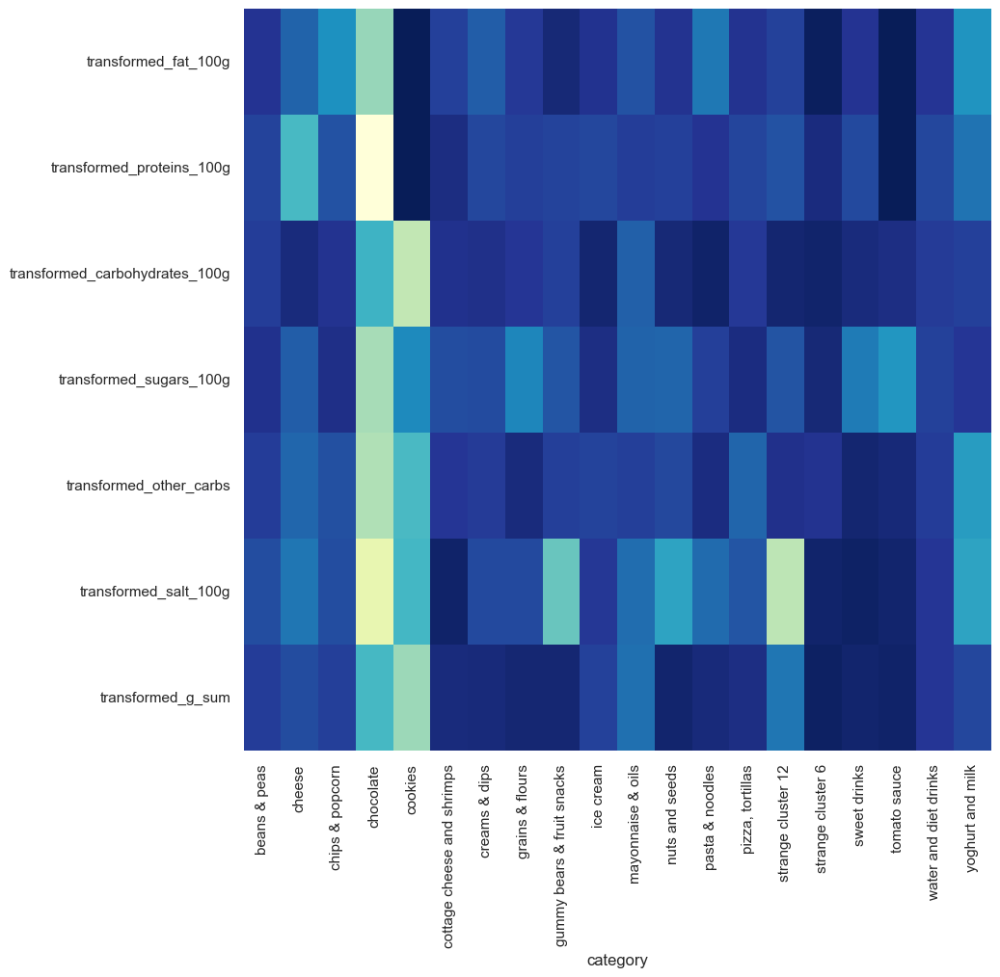

In [38]:
plt.figure(figsize=(10,10))
q75 = nutrition_table.groupby("category")[transformed_nutrients].quantile(0.75)
q25 = nutrition_table.groupby("category")[transformed_nutrients].quantile(0.25)
iqr = q75-q25
sns.heatmap(iqr.transpose(), cmap="YlGnBu_r", cbar=False);

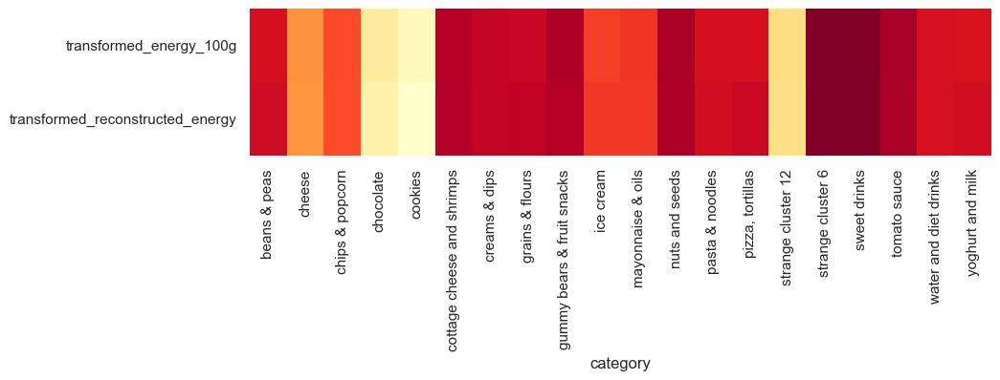

In [39]:
plt.figure(figsize=(10,2))
q75 = nutrition_table.groupby("category")[["transformed_energy_100g",
                                          "transformed_reconstructed_energy"]].quantile(0.75)
q25 = nutrition_table.groupby("category")[["transformed_energy_100g",
                                          "transformed_reconstructed_energy"]].quantile(0.25)
iqr = q75-q25
energy_difference = iqr.transformed_energy_100g - iqr.transformed_reconstructed_energy
sns.heatmap(iqr.transpose(), cmap="YlOrRd_r", cbar=False);

In [40]:
species_probas = model.predict_proba(X_train)
best_species_idx = np.argmax(species_probas,axis=1)

color = np.zeros(best_species_idx.shape[0])
for n in range(len(color)):
    color[n] = np.round(species_probas[n,best_species_idx[n]], 4)
nutrition_table["certainty"] = color


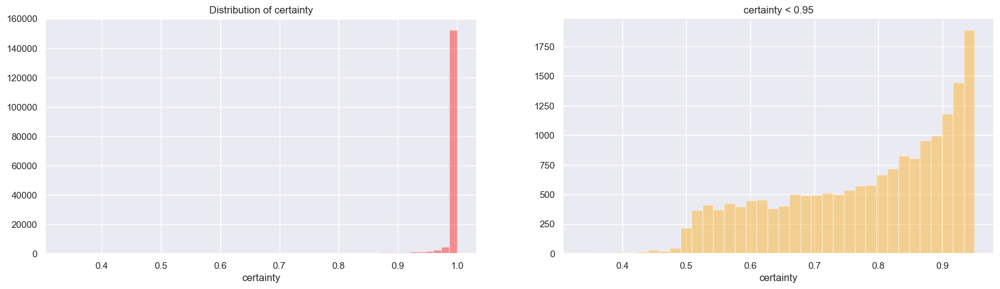

In [41]:
fig, ax = plt.subplots(1,2, figsize = (20,5))
sns.distplot(nutrition_table.certainty, color = "red", ax = ax[0],kde = False)
sns.distplot(nutrition_table.certainty[nutrition_table.certainty < 0.95], color = "orange", kde = False)
ax[0].set_title("Distribution of certainty")
ax[1].set_title("certainty < 0.95");


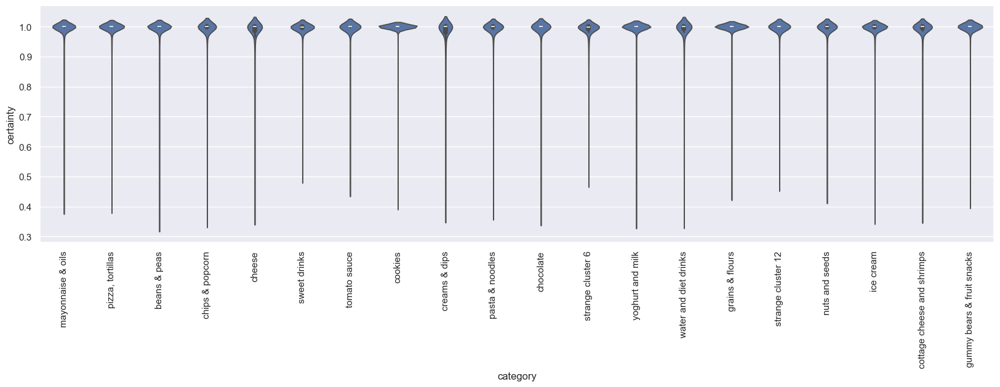

In [42]:
plt.figure(figsize=(20,5))
sns.violinplot(x="category", y="certainty", data=nutrition_table);
plt.xticks(rotation=90);

In [43]:
cluster_pair=[9, 16]

<Axes: title={'center': 'cluster:16 // certainty < 1.0'}>

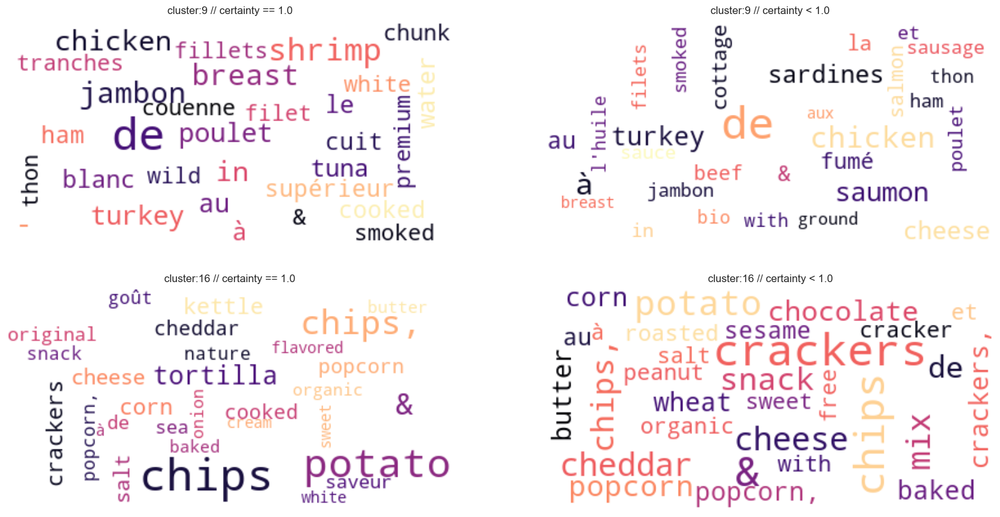

In [44]:
fig, ax = plt.subplots(2,2, figsize = (20,10))
make_word_cloud(nutrition_table[nutrition_table.certainty == 1.],
                cluster_pair[0],
                ax[0,0],
                title = "cluster:" + str(cluster_pair[0]) + " // " + "certainty == 1.0")
make_word_cloud(nutrition_table[nutrition_table.certainty < 1.],
                cluster_pair[0],
                ax[0,1],
                title = "cluster:" + str(cluster_pair[0]) + " // " + "certainty < 1.0")

make_word_cloud(nutrition_table[nutrition_table.certainty == 1.],
                cluster_pair[1],
                ax[1,0],
                title = "cluster:" + str(cluster_pair[1]) + " // " + "certainty == 1.0")
make_word_cloud(nutrition_table[nutrition_table.certainty < 1.],
                cluster_pair[1],
                ax[1,1],
                title = "cluster:" + str(cluster_pair[1]) + " // " + "certainty < 1.0")

In [45]:
nutrition_table["alternative_cluster"] = np.argsort(species_probas, axis=1)[:,-2]
nutrition_table["alternative_category"] = nutrition_table.alternative_cluster.map(cluster_names)
uncertain_table = nutrition_table[nutrition_table.certainty < 0.95]

In [46]:
competition = np.round(100 * uncertain_table.groupby(
    "category").alternative_category.value_counts() / uncertain_table.groupby(
    "category").alternative_category.count())
competition = competition.unstack()
competition.fillna(0, inplace=True)

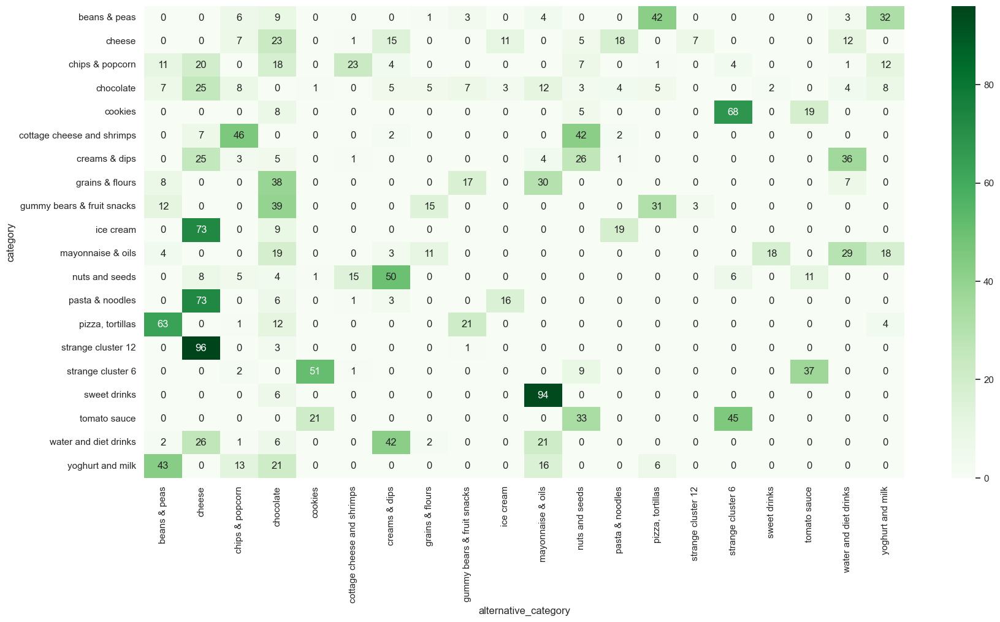

In [47]:
plt.figure(figsize=(20,10))
sns.heatmap(competition, cmap="Greens", annot=True, fmt="g");

In [48]:
trace2 = go.Scatter3d(
    x=nutrition_table[plot_features[0]].values[0:N], 
    y=nutrition_table[plot_features[1]].values[0:N],
    z=nutrition_table[plot_features[2]].values[0:N],
    mode='markers',
    text = nutrition_table["product"].values[0:N],
    marker=dict(
        color= color,
        colorscale = "Blackbody",
        opacity=0.5,
        size=4
    )
)

figure_data = [trace2]
layout = go.Layout(
    title = 'Certainty of Clustering',
    scene = dict(
        xaxis = dict(title= plot_features[0]),
        yaxis = dict(title= plot_features[1]),
        zaxis = dict(title= plot_features[2]),
    ),
        margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    showlegend=True
)

fig = go.Figure(data=figure_data, layout=layout)
py.iplot(fig, filename='simple-3d-scatter')

In [49]:
log_prob = model.score_samples(X_train)

In [50]:
your_choice = 0.07

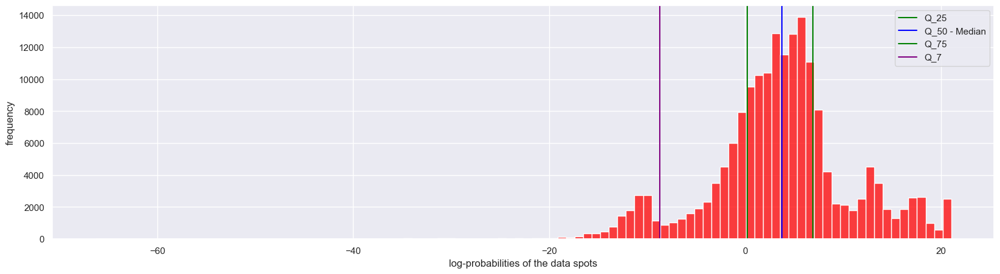

In [51]:
plt.figure(figsize=(20, 5))

# Assuming `log_prob` and `your_choice` are defined earlier in your code.
sns.histplot(log_prob, kde=False, bins=100, color="Red")  # Updated to use `sns.histplot` (modern replacement for `sns.distplot`).
g1 = plt.axvline(np.quantile(log_prob, 0.25), color="Green", label="Q_25")
g2 = plt.axvline(np.quantile(log_prob, 0.5), color="Blue", label="Q_50 - Median")
g3 = plt.axvline(np.quantile(log_prob, 0.75), color="Green", label="Q_75")
g4 = plt.axvline(np.quantile(log_prob, your_choice), color="Purple", label=f"Q_{int(your_choice * 100)}")

# Include handles and labels explicitly in the legend
handles = [g1, g2, g3, g4]
labels = ["Q_25", "Q_50 - Median", "Q_75", f"Q_{int(your_choice * 100)}"]
plt.xlabel("log-probabilities of the data spots")
plt.ylabel("frequency")
plt.legend(handles=handles, labels=labels)

plt.show()


In [52]:
outliers = get_outliers(log_prob, your_choice)
nutrition_table["anomaly"] = outliers

Index([0], dtype='object')


Text(0, 0.5, 'Percentage of Anomalies')

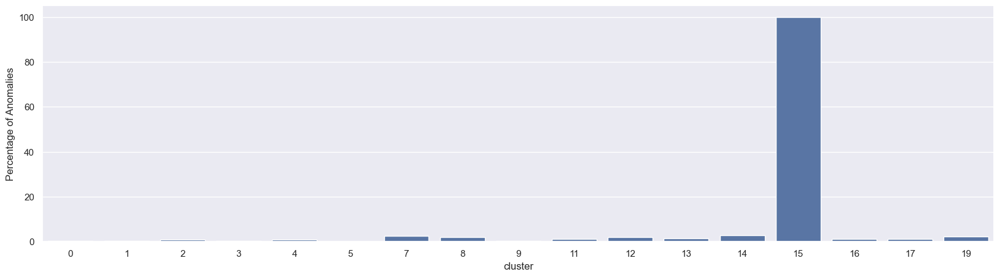

In [53]:
# Assuming 'anomaly' is the correct column name in the nutrition_table DataFrame
anomalies_per_cluster = nutrition_table.groupby("cluster")['anomaly'].value_counts() / nutrition_table.groupby("cluster")['anomaly'].count()
reset = anomalies_per_cluster.reset_index(level="cluster")
percentage_anomalies = reset.loc[1].set_index("cluster", drop=True)

# Now check the column names of percentage_anomalies
print(percentage_anomalies.columns)

# Assuming the correct column name is 0, update the plotting code
plt.figure(figsize=(20, 5))
sns.barplot(x=percentage_anomalies.index, y=percentage_anomalies[0] * 100)
plt.ylabel("Percentage of Anomalies")



In [54]:
print(percentage_anomalies.columns)

Index([0], dtype='object')


<Axes: title={'center': 'Similar outlier cluster 12'}>

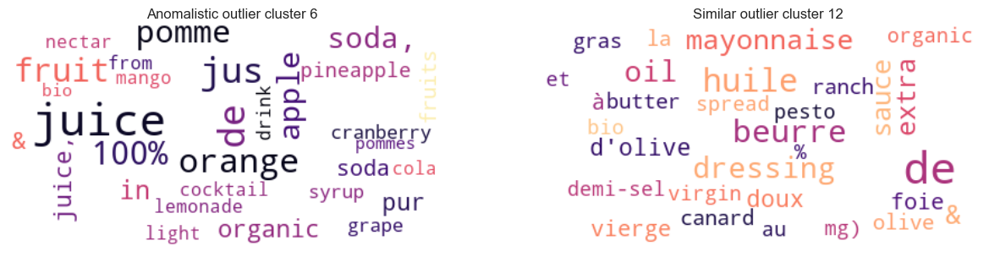

In [55]:
fig, ax = plt.subplots(1,2,figsize=(15,5))
make_word_cloud(nutrition_table,
                6,
                ax[0],
                title = "Anomalistic outlier cluster 6")
make_word_cloud(nutrition_table,
                12,
                ax[1],
                title = "Similar outlier cluster 12")

In [56]:
features = ["energy_100g", "reconstructed_energy"]

(0.0, 4000.0)

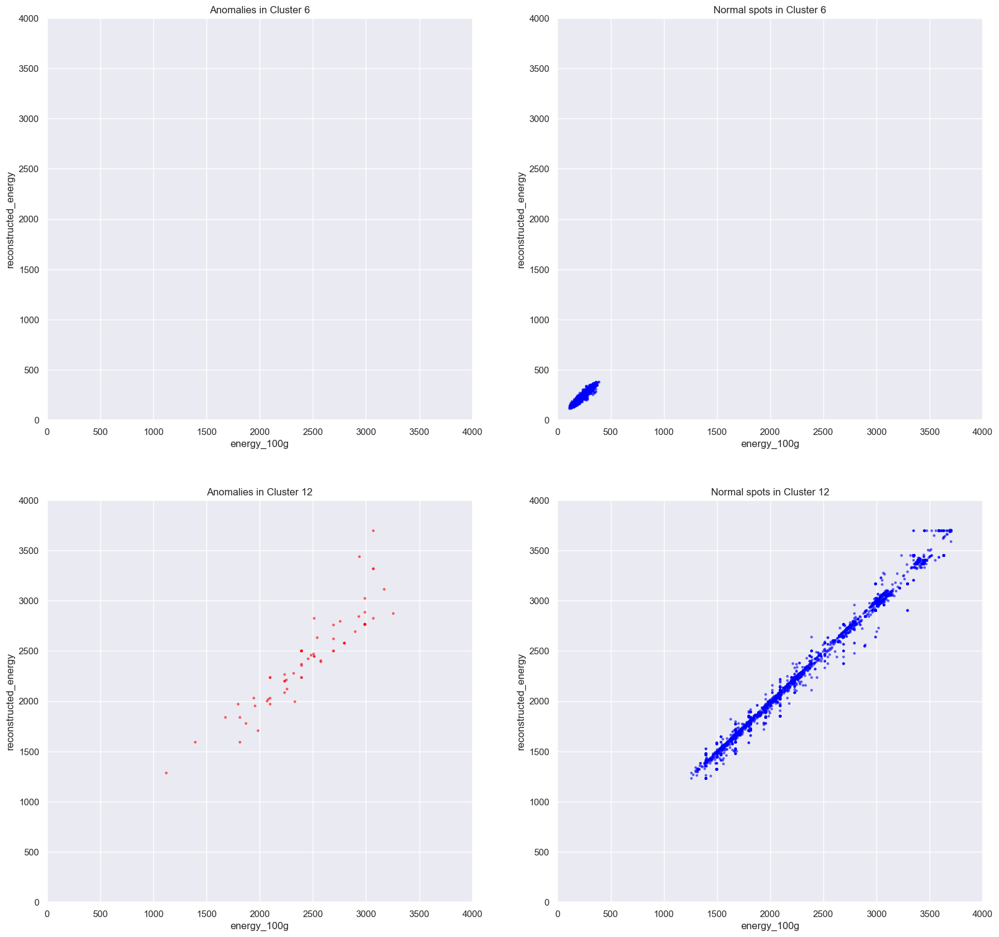

In [57]:
def get_values(cluster, feature, anomal):
    x = nutrition_table[(nutrition_table.cluster == cluster) & (nutrition_table.anomaly==anomal)][feature].values
    return x

size = 5
alpha = 0.5

fig, ax = plt.subplots(2,2, figsize = (20,19))
ax[0,0].scatter(get_values(6, features[0], 1),get_values(6, features[1], 1), c = "red",s=size, alpha=alpha)
ax[0,1].scatter(get_values(6, features[0], 0), get_values(6, features[1], 0), c = "blue",s=size, alpha=alpha)
ax[1,0].scatter(get_values(12, features[0], 1), get_values(12, features[1], 1), c = "red",s=size, alpha=alpha)
ax[1,1].scatter(get_values(12, features[0], 0), get_values(12, features[1], 0), c = "blue",s=size, alpha=alpha)
for n in range(2):
    for m in range(2):
        ax[n,m].set_xlabel(features[0])
        ax[n,m].set_ylabel(features[1])
ax[0,0].set_title("Anomalies in Cluster 6")
ax[0,1].set_title("Normal spots in Cluster 6")
ax[1,0].set_title("Anomalies in Cluster 12")
ax[1,1].set_title("Normal spots in Cluster 12")
ax[0,0].set_xlim([0,4000])
ax[0,1].set_xlim([0,4000])
ax[1,0].set_xlim([0,4000])
ax[1,1].set_xlim([0,4000])
ax[0,0].set_ylim([0,4000])
ax[0,1].set_ylim([0,4000])
ax[1,0].set_ylim([0,4000])
ax[1,1].set_ylim([0,4000])

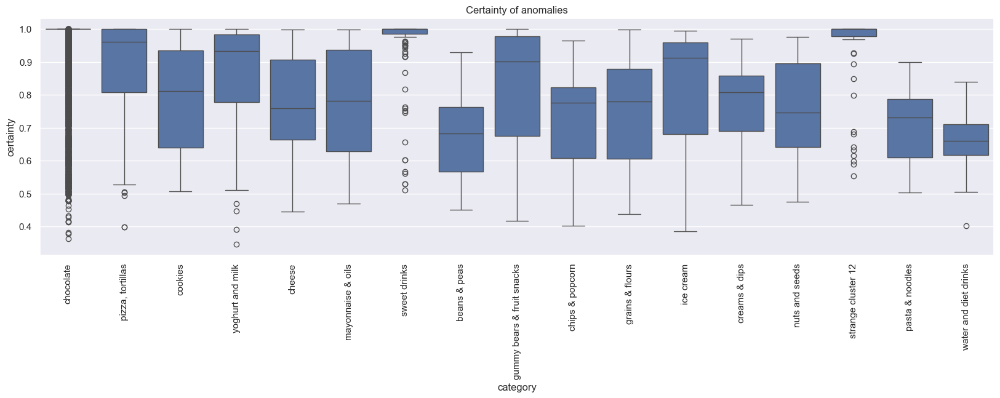

In [58]:
plt.figure(figsize=(20,5))
sns.boxplot(x="category", y="certainty", data=nutrition_table[nutrition_table.anomaly==1])
plt.title("Certainty of anomalies");
plt.xticks(rotation=90);

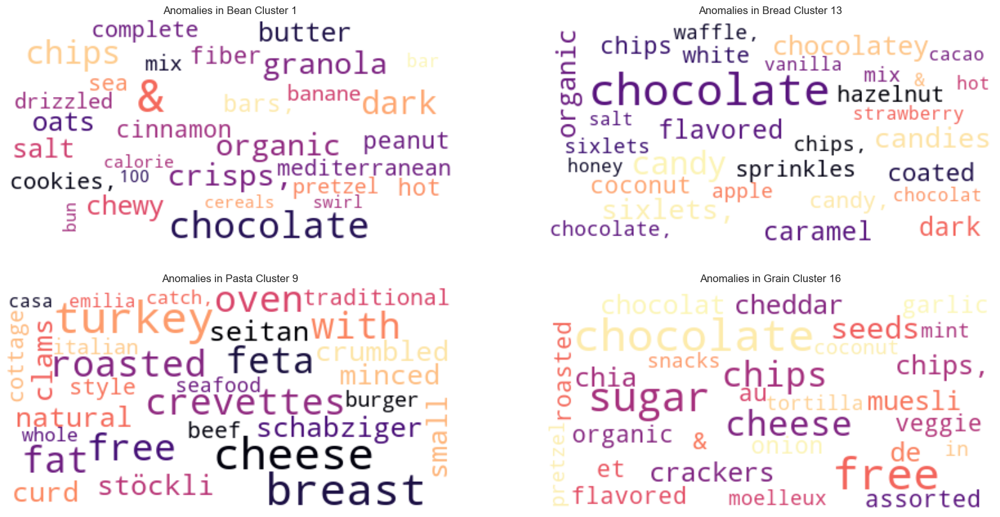

In [59]:
fig, ax = plt.subplots(2,2, figsize=(20,10))
make_word_cloud(nutrition_table[nutrition_table.anomaly==1], 1, ax[0,0], "Anomalies in Bean Cluster 1")
make_word_cloud(nutrition_table[nutrition_table.anomaly==1], 13, ax[0,1], "Anomalies in Bread Cluster 13")
make_word_cloud(nutrition_table[nutrition_table.anomaly==1], 9, ax[1,0], "Anomalies in Pasta Cluster 9")
make_word_cloud(nutrition_table[nutrition_table.anomaly==1], 16, ax[1,1], "Anomalies in Grain Cluster 16");

In [60]:
plot_features = ["energy_100g", "reconstructed_energy", "g_sum"]


In [61]:
trace2 = go.Scatter3d(
    x=nutrition_table[plot_features[0]].values[0:N], 
    y=nutrition_table[plot_features[1]].values[0:N],
    z=nutrition_table[plot_features[2]].values[0:N],
    mode='markers',
    text = nutrition_table["product"].values[0:N],
    marker=dict(
        color=nutrition_table.anomaly.values,
        colorscale = "Portland",
        opacity=0.8,
        size=4
    )
)

figure_data = [trace2]
layout = go.Layout(
    title = 'Log3D of Proteins, Fat and Carbohydrates',
    scene = dict(
        xaxis = dict(title=plot_features[0]),
        yaxis = dict(title=plot_features[1]),
        zaxis = dict(title=plot_features[2]),
    ),
        margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    showlegend=True
)

fig = go.Figure(data=figure_data, layout=layout)
py.iplot(fig, filename='simple-3d-scatter')


In [62]:
nutrition_table.to_csv("Secrets_of_SuperMarket.csv")

In [63]:
nutrition_table["nutri_score"] = original.loc[nutrition_table.index, "nutrition-score-fr_100g"]
nutrition_table.nutri_score.isnull().value_counts() / nutrition_table.shape[0]

nutri_score
False    0.915542
True     0.084458
Name: count, dtype: float64

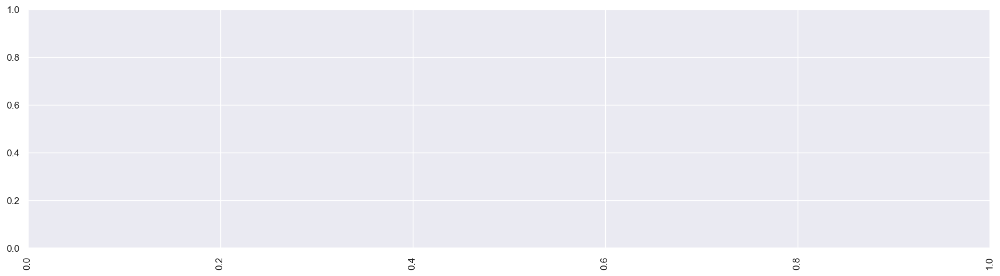

In [64]:
plt.figure(figsize=(20,5))
#sns.boxplot(x="category", y="nutri_score", hue="", palette="magma", data=nutrition_table)
plt.xticks(rotation=90);
